In [0]:
#pip install geopandas #You should install geopandas

#pip install python-igraph

# Understanding Geopandas

In [0]:
%matplotlib inline 
## It is to avoiding to open an extra window showing maps
import geopandas as gpd

##Data Source

http://geoftp.ibge.gov.br/organizacao_do_territorio/malhas_territoriais/malhas_municipais/municipio_2018/UFs/

In [0]:
sp = gpd.read_file('35MUE250GC_SIR.shp')

In [293]:
type(sp)

geopandas.geodataframe.GeoDataFrame

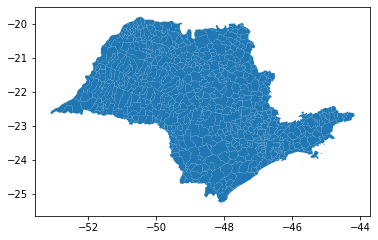

In [294]:
sp.plot()

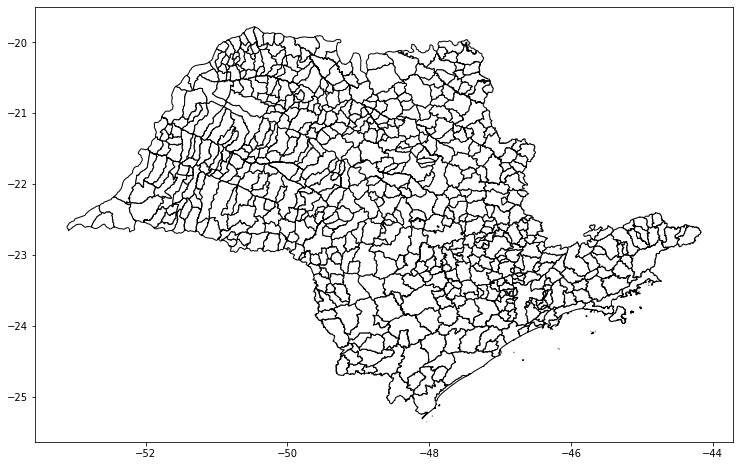

In [295]:
sp.plot(color='white', edgecolor='black', figsize=(15,8))

##Creating a new shapefile



In [296]:
sp = sp[sp['NM_MUNICIP'] == 'SÃO JOSÉ DOS CAMPOS']
sp.shape

(1, 3)

In [297]:
sp

,NM_MUNICIP,CD_GEOCMU,geometry
114,SÃO JOSÉ DOS CAMPOS,3549904,"POLYGON ((-45.76036 -23.12855, -45.76041 -23.1..."


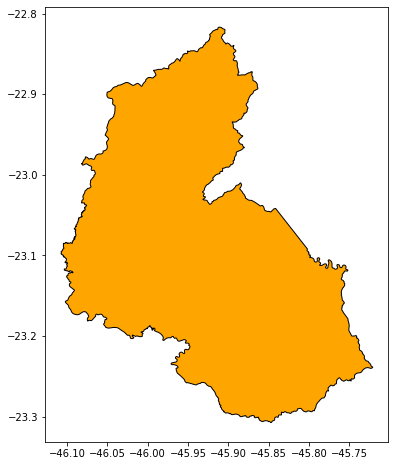

In [298]:
sp.plot(color='orange', edgecolor='black', figsize=(15,8))

##Saving Data

In [0]:
import os

dir = '../01.Dados/Mapas/SP-MUNIC'
if not os.path.exists(dir): 
    os.makedirs(dir)

In [0]:
sp.to_file(dir + '/SP-MUNIC.shp')

In [0]:
sjc = gpd.read_file(dir + '/SP-MUNIC.shp')

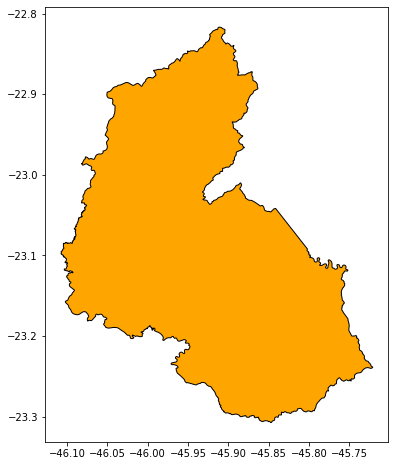

In [302]:
sjc.plot(color='orange', edgecolor='black', figsize=(15,8))

##Transforming DataFrame into GeoDataFrame

In [0]:
%matplotlib inline
import pandas as pd
import geopandas as gpd

In [305]:
data = pd.read_csv("zones_coordinates.csv", encoding = "ISO-8859-1")

data

,Nome_ZT,XCOORD,YCOORD
0,Centro,-45.886701,-23.190638
1,Vila Maria e Vila Santa Luzia,-45.882070,-23.178009
2,Jardim Paulista e Monte Castelo,-45.873745,-23.182939
3,Vila São Pedro e Jardim Jussara,-45.869327,-23.188904
4,Vila Piratininga e Jardim Augusta,-45.880360,-23.195879
5,Vila Adyanna e Vila Betânia,-45.892252,-23.203218
6,Vila Ema e Jardim Esplanada,-45.902175,-23.199704
7,Santana e Vila Rossi,-45.898069,-23.165302
8,Vila Industrial e VilaTatetuba,-45.857077,-23.180798
9,Jardim da Granja e Jardim Souto,-45.858072,-23.202252


##Creating geometry column

In [306]:
from shapely.geometry import Point

x =  zip(data.XCOORD, data.YCOORD)
x

In [307]:
geometry = [Point(x) for x in zip(data.XCOORD, data.YCOORD)]
geometry

In [0]:
crs = {'proj': 'latlong', 'ellps': 'WGS84', 'datum': 'WGS84', 'no_defs': True}

geo_data = gpd.GeoDataFrame(data, crs = crs, geometry = geometry)

In [309]:
geo_data

,Nome_ZT,XCOORD,YCOORD,geometry
0,Centro,-45.886701,-23.190638,POINT (-45.88670 -23.19064)
1,Vila Maria e Vila Santa Luzia,-45.882070,-23.178009,POINT (-45.88207 -23.17801)
2,Jardim Paulista e Monte Castelo,-45.873745,-23.182939,POINT (-45.87374 -23.18294)
3,Vila São Pedro e Jardim Jussara,-45.869327,-23.188904,POINT (-45.86933 -23.18890)
4,Vila Piratininga e Jardim Augusta,-45.880360,-23.195879,POINT (-45.88036 -23.19588)
5,Vila Adyanna e Vila Betânia,-45.892252,-23.203218,POINT (-45.89225 -23.20322)
6,Vila Ema e Jardim Esplanada,-45.902175,-23.199704,POINT (-45.90217 -23.19970)
7,Santana e Vila Rossi,-45.898069,-23.165302,POINT (-45.89807 -23.16530)
8,Vila Industrial e VilaTatetuba,-45.857077,-23.180798,POINT (-45.85708 -23.18080)
9,Jardim da Granja e Jardim Souto,-45.858072,-23.202252,POINT (-45.85807 -23.20225)


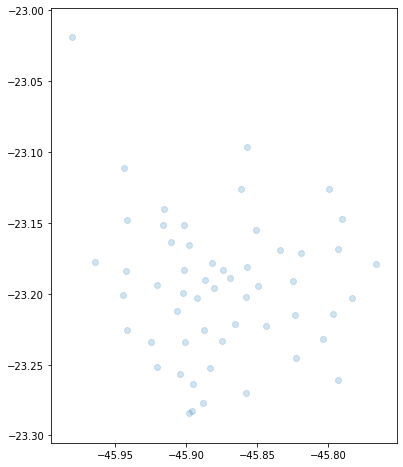

In [310]:
import os

dir = '../01.Dados/Mapas/SP-DATASET'
if not os.path.exists(dir):
    os.makedirs(dir)

geo_data.to_file(dir + '/DATASET.shp')

geo_data.plot(figsize=(15,8), alpha=0.2)

#Modifying CRS from Files

   - https://www.lapig.iesa.ufg.br/lapig/cursos_online/gvsig/a_projeo_utm_no_brasil.html

   - http://www.spatialreference.org/

In [0]:
import geopandas as gpd

sjc = gpd.read_file('../01.Dados/Mapas/SP-MUNIC/SP-MUNIC.shp')
geo_data = gpd.read_file('../01.Dados/Mapas/SP-DATASET/DATASET.shp')

In [312]:
sjc

,NM_MUNICIP,CD_GEOCMU,geometry
0,SÃO JOSÉ DOS CAMPOS,3549904,"POLYGON ((-45.76036 -23.12855, -45.76041 -23.1..."


In [313]:
sjc.crs

{'init': 'epsg:4674'}

In [314]:
geo_data.crs

{'init': 'epsg:4326'}

###You should search in this website about which one is the most suitable for your area:
[link text](https://)www.spatialreference.org/

###So, try to modify your crs:

In [315]:
sjc = sjc.to_crs('+proj=utm +zone=23 +south +ellps=GRS80 +towgs84=0,0,0,0,0,0,0 +units=km +no_defs')

/usr/local/lib/python3.6/dist-packages/pyproj/crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


In [316]:
geo_data = geo_data.to_crs('+proj=utm +zone=23 +south +ellps=GRS80 +towgs84=0,0,0,0,0,0,0 +units=km +no_defs')

/usr/local/lib/python3.6/dist-packages/pyproj/crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


In [317]:
sjc.crs

'+proj=utm +zone=23 +south +ellps=GRS80 +towgs84=0,0,0,0,0,0,0 +units=km +no_defs'

In [318]:
geo_data.crs

'+proj=utm +zone=23 +south +ellps=GRS80 +towgs84=0,0,0,0,0,0,0 +units=km +no_defs'

In [0]:
sjc.to_file('../01.Dados/Mapas/SP-MUNIC/SP-MUNIC.shp')
geo_data.to_file('../01.Dados/Mapas/SP-DATASET/DATASET.shp')

In [0]:
sjc2 = gpd.read_file('../01.Dados/Mapas/SP-MUNIC/SP-MUNIC.shp')
geo_data2 = gpd.read_file('../01.Dados/Mapas/SP-DATASET/DATASET.shp')

In [321]:
sjc2.crs

{'ellps': 'GRS80',
 'no_defs': True,
 'proj': 'utm',
 'south': True,
 'units': 'km',
 'zone': 23}

In [322]:
sjc2

,NM_MUNICIP,CD_GEOCMU,geometry
0,SÃO JOSÉ DOS CAMPOS,3549904,"POLYGON ((422.149 7442.047, 422.144 7442.031, ..."


In [323]:
geo_data2

,Nome_ZT,XCOORD,YCOORD,geometry
0,Centro,-45.886701,-23.190638,POINT (409.255 7435.100)
1,Vila Maria e Vila Santa Luzia,-45.882070,-23.178009,POINT (409.721 7436.501)
2,Jardim Paulista e Monte Castelo,-45.873745,-23.182939,POINT (410.576 7435.960)
3,Vila São Pedro e Jardim Jussara,-45.869327,-23.188904,POINT (411.032 7435.303)
4,Vila Piratininga e Jardim Augusta,-45.880360,-23.195879,POINT (409.908 7434.524)
5,Vila Adyanna e Vila Betânia,-45.892252,-23.203218,POINT (408.696 7433.704)
6,Vila Ema e Jardim Esplanada,-45.902175,-23.199704,POINT (407.678 7434.086)
7,Santana e Vila Rossi,-45.898069,-23.165302,POINT (408.074 7437.898)
8,Vila Industrial e VilaTatetuba,-45.857077,-23.180798,POINT (412.281 7436.207)
9,Jardim da Granja e Jardim Souto,-45.858072,-23.202252,POINT (412.193 7433.832)


##Plotting layers, one over another

In [0]:
%matplotlib inline
import geopandas as gpd

sjc = gpd.read_file('../01.Dados/Mapas/SP-MUNIC/SP-MUNIC.shp')
geo_data = gpd.read_file('../01.Dados/Mapas/SP-DATASET/DATASET.shp')

In [325]:
sjc.crs

{'ellps': 'GRS80',
 'no_defs': True,
 'proj': 'utm',
 'south': True,
 'units': 'km',
 'zone': 23}

In [326]:
geo_data.crs

{'ellps': 'GRS80',
 'no_defs': True,
 'proj': 'utm',
 'south': True,
 'units': 'km',
 'zone': 23}

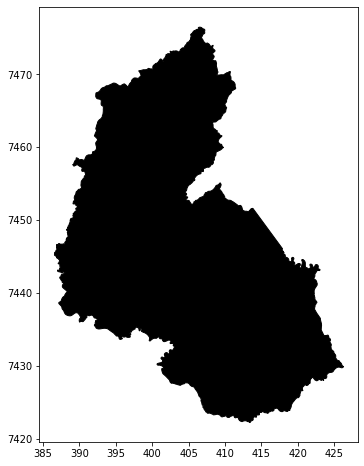

In [327]:
base = sjc.plot(color='black', edgecolor='black', figsize=(15,8))
base

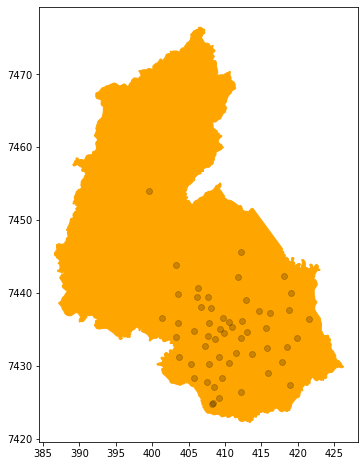

In [328]:
base = sjc.plot(color='orange', edgecolor='orange', figsize=(15,8))
geo_data.plot(ax=base, figsize=(15,8), color='black', alpha=0.2)

##Filtering points, only which one inside the base should be plotted

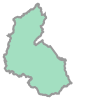

In [329]:
sjc.iloc[0].geometry

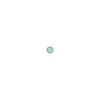

In [330]:
geo_data.iloc[0].geometry

In [331]:
geo_data.iloc[0].geometry.within(sjc.iloc[0].geometry)

True

In [332]:
sjc.iloc[0].geometry.contains(geo_data.iloc[0].geometry)

True

In [333]:
geo_data['geometry'].within(sjc.iloc[0].geometry)

0     True
1     True
2     True
3     True
4     True
5     True
6     True
7     True
8     True
9     True
10    True
11    True
12    True
13    True
14    True
15    True
16    True
17    True
18    True
19    True
20    True
21    True
22    True
23    True
24    True
25    True
26    True
27    True
28    True
29    True
30    True
31    True
32    True
33    True
34    True
35    True
36    True
37    True
38    True
39    True
40    True
41    True
42    True
43    True
44    True
45    True
46    True
47    True
48    True
49    True
50    True
51    True
52    True
53    True
54    True
dtype: bool

In [334]:
sample_geo_data = geo_data.iloc[0:12]
sample_geo_data

,Nome_ZT,XCOORD,YCOORD,geometry
0,Centro,-45.886701,-23.190638,POINT (409.255 7435.100)
1,Vila Maria e Vila Santa Luzia,-45.882070,-23.178009,POINT (409.721 7436.501)
2,Jardim Paulista e Monte Castelo,-45.873745,-23.182939,POINT (410.576 7435.960)
3,Vila São Pedro e Jardim Jussara,-45.869327,-23.188904,POINT (411.032 7435.303)
4,Vila Piratininga e Jardim Augusta,-45.880360,-23.195879,POINT (409.908 7434.524)
5,Vila Adyanna e Vila Betânia,-45.892252,-23.203218,POINT (408.696 7433.704)
6,Vila Ema e Jardim Esplanada,-45.902175,-23.199704,POINT (407.678 7434.086)
7,Santana e Vila Rossi,-45.898069,-23.165302,POINT (408.074 7437.898)
8,Vila Industrial e VilaTatetuba,-45.857077,-23.180798,POINT (412.281 7436.207)
9,Jardim da Granja e Jardim Souto,-45.858072,-23.202252,POINT (412.193 7433.832)


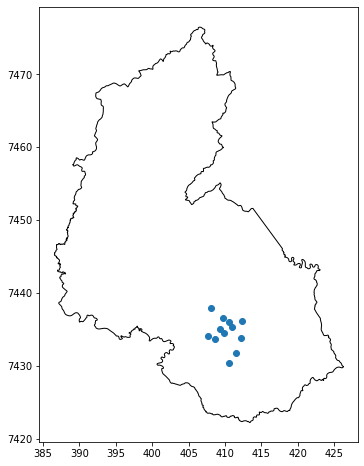

In [335]:
sample = geo_data.iloc[:12]
base = sjc.plot(color='white', edgecolor='black', figsize=(15,8))
sample.plot(ax=base, figsize=(15,8), alpha=1)

In [336]:
before = geo_data.shape[0]
before

55

In [0]:
geo_data = geo_data[geo_data['geometry'].within(sjc.iloc[0].geometry)]

In [338]:
geo_data

,Nome_ZT,XCOORD,YCOORD,geometry
0,Centro,-45.886701,-23.190638,POINT (409.255 7435.100)
1,Vila Maria e Vila Santa Luzia,-45.882070,-23.178009,POINT (409.721 7436.501)
2,Jardim Paulista e Monte Castelo,-45.873745,-23.182939,POINT (410.576 7435.960)
3,Vila São Pedro e Jardim Jussara,-45.869327,-23.188904,POINT (411.032 7435.303)
4,Vila Piratininga e Jardim Augusta,-45.880360,-23.195879,POINT (409.908 7434.524)
5,Vila Adyanna e Vila Betânia,-45.892252,-23.203218,POINT (408.696 7433.704)
6,Vila Ema e Jardim Esplanada,-45.902175,-23.199704,POINT (407.678 7434.086)
7,Santana e Vila Rossi,-45.898069,-23.165302,POINT (408.074 7437.898)
8,Vila Industrial e VilaTatetuba,-45.857077,-23.180798,POINT (412.281 7436.207)
9,Jardim da Granja e Jardim Souto,-45.858072,-23.202252,POINT (412.193 7433.832)


In [0]:
after = geo_data.shape[0]

In [340]:
before-after

0

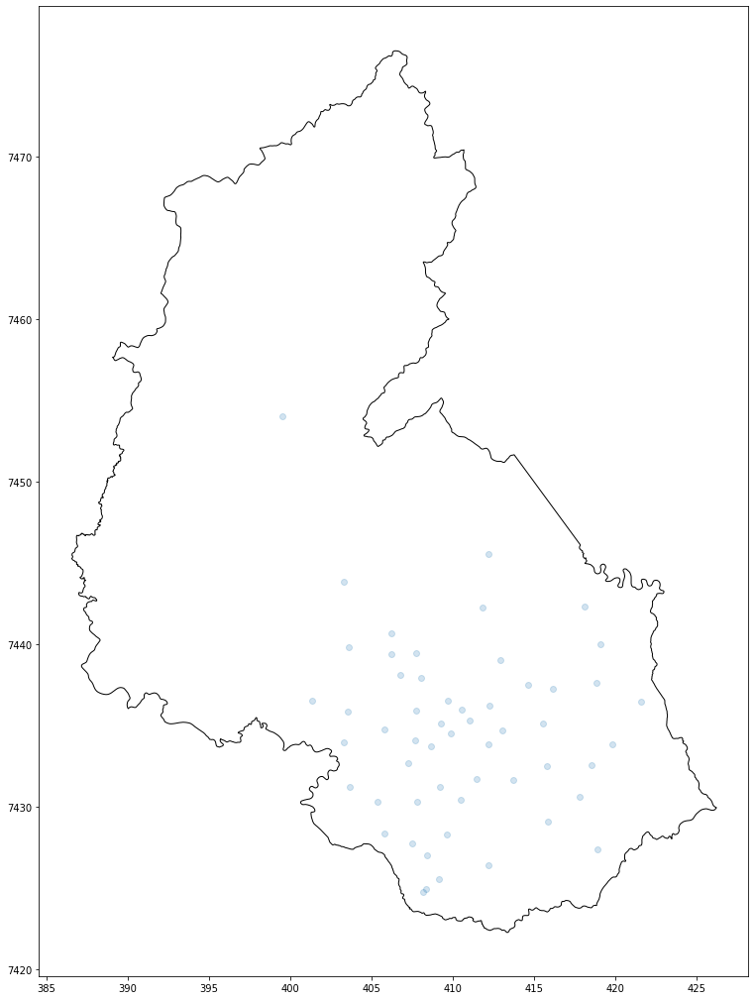

In [341]:
base = sjc.plot(color='white', edgecolor='black', figsize=(25,18))
geo_data.plot(ax=base, figsize=(25,18), alpha=0.2)

In [0]:
geo_data.to_file('../01.Dados/Mapas/SP-DATASET/DATASET.shp')

###Reading x1x2_correlation.csv

In [0]:
def calculate_correlation_with_limiar_x(limiar):
  correlation_dataframe = pd.read_csv("x1x2_correlations.csv", encoding = "ISO-8859-1")
  
  correlation_dataframe = correlation_dataframe[correlation_dataframe['corr'] > limiar]
    
  correlation_dataframe = correlation_dataframe.reset_index(drop=True)
  correlation_dataframe = correlation_dataframe.astype({"X1": int, "X2": int})
    
  return correlation_dataframe

In [0]:
#Creating our graph

from igraph import *

def create_graph(limiar):
  correlation_dataframe = calculate_correlation_with_limiar_x(limiar)

  g = Graph()
  g.add_vertices(56)

  #Adding edges to the graph
  lista = [tuple(r) for r in correlation_dataframe[['X1', 'X2']].values]
  
  g.add_edges(lista)
  return g


# def calculate_avg_shortest_path(g):
#     print("Shortest path from node: ")
#     for v in g.vs:
#       print(g.get_shortest_paths(v, to=None, weights=None, mode=OUT, output="vpath"))
#       # print(g.shortest_paths_dijkstra(source=None, target=None, weights=None, mode=OUT))
#       # print(g.shortest_paths(source=None, target=None, weights=None, mode=ALL))

def calculate_avg_eccentricity(g):
  return sum(g.eccentricity(vertices=None, mode=IN))/len(g.vs)


list_of_metrics = []

import numpy

max_diam = 0.0
max_limiar_diam = 0.0

for i in numpy.arange(0, 1, 0.01):
    limiar = round(i, 2)
    g = create_graph(limiar)
    
    diam = g.diameter(directed=False, unconn=True, weights=None)

    if(diam > max_diam):
        max_diam = diam
        max_limiar_diam = limiar

    list_of_metrics.append(tuple((limiar, calculate_avg_eccentricity(g), g.average_path_length(directed=True, unconn=True),
                                  g.transitivity_undirected(mode="nan"),
                                  round(mean(g.degree()), 4), g.vcount(), g.ecount(), 
                                  diam, 
                                  len(g.clusters(mode=STRONG)))))

#g = create_graph(round(0, 2))

g = create_graph(max_limiar_diam)

list_degree_max_diam = g.vs.degree()

metrics = pd.DataFrame(list_of_metrics, columns = ['Limiar', 'avg_eccentricity', 'avg_path_len', 'transitivity' ,'avg_degree', 'num_nodes', 'num_edges', 'diameter', 'clusters'])
metrics

metrics.to_csv('metrics.csv')

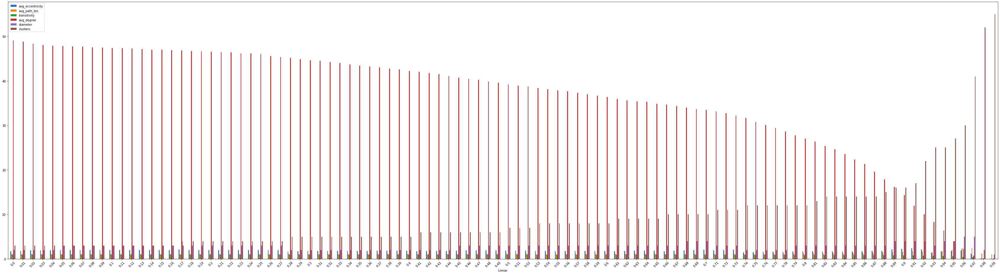

In [358]:
import pandas as pd
from sklearn import preprocessing

limiar = metrics[['Limiar']]

metrics_to_plot = metrics[['avg_eccentricity', 'avg_path_len','transitivity', 'avg_degree', 'diameter', 'clusters']]

# #This lines is to normalize the dataframe
# x = metrics_to_plot.values #returns a numpy array
# min_max_scaler = preprocessing.MinMaxScaler()
# x_scaled = min_max_scaler.fit_transform(x)
# metrics_to_plot = pd.DataFrame(x_scaled, columns = ['avg_eccentricity', 'avg_path_len','transitivity','avg_degree', 'diameter', 'clusters'])
# #####


metrics_to_plot = pd.concat([limiar, metrics_to_plot], axis=1)
# metrics_to_plot

import matplotlib.pyplot as plt
import pandas as pd

metrics_to_plot.plot.bar(rot=45, figsize=(60, 16), x='Limiar')
plt.savefig('metrics.pdf')
plt.show()



In [359]:
correlations = calculate_correlation_with_limiar_x(max_limiar_diam)
correlations = correlations.astype({"X1": int, "X2": int})

correlations['X1Coord'] = correlations['X1'].apply(lambda x: geo_data.iloc[x-1, 3])
correlations['X2Coord'] = correlations['X2'].apply(lambda x: geo_data.iloc[x-1, 3])
correlations

,X1,X2,corr,X1Coord,X2Coord
0,2,14,0.961129,POINT (409.7206112457598 7436.500939446017),POINT (407.2696111613205 7432.674253113188)
1,2,25,0.971108,POINT (409.7206112457598 7436.500939446017),POINT (409.6542281287472 7428.256296048133)
2,2,43,0.967998,POINT (409.7206112457598 7436.500939446017),POINT (418.8419288252763 7437.583824254926)
3,3,5,0.983329,POINT (410.5759932133388 7435.960272516845),POINT (409.9076083043934 7434.523586138427)
4,4,10,0.983618,POINT (411.0321257948857 7435.30258836438),POINT (412.1927525664005 7433.831654905097)
...,...,...,...,...,...
59,31,45,0.979511,POINT (405.8015014936311 7428.337640669276),POINT (421.5781728828155 7436.460794593278)
60,31,46,0.971198,POINT (405.8015014936311 7428.337640669276),POINT (418.9268260675544 7427.346843084749)
61,32,33,0.975834,POINT (405.3673578074093 7430.307203117989),POINT (403.6431811118384 7431.193601419287)
62,43,45,0.973146,POINT (418.8419288252763 7437.583824254926),POINT (421.5781728828155 7436.460794593278)


In [360]:
from shapely.geometry import LineString

y =  zip(correlations.X1Coord, correlations.X2Coord)
y

In [0]:
geometry = [LineString(xy) for xy in zip(correlations.X1Coord, correlations.X2Coord)]
#geometry

In [362]:
crs = {'proj': 'latlong', 'ellps': 'WGS84', 'datum': 'WGS84', 'no_defs': True}

geo_data_correlations = gpd.GeoDataFrame(correlations, crs = crs, geometry = geometry)
geo_data_correlations

,X1,X2,corr,X1Coord,X2Coord,geometry
0,2,14,0.961129,POINT (409.7206112457598 7436.500939446017),POINT (407.2696111613205 7432.674253113188),"LINESTRING (409.721 7436.501, 407.270 7432.674)"
1,2,25,0.971108,POINT (409.7206112457598 7436.500939446017),POINT (409.6542281287472 7428.256296048133),"LINESTRING (409.721 7436.501, 409.654 7428.256)"
2,2,43,0.967998,POINT (409.7206112457598 7436.500939446017),POINT (418.8419288252763 7437.583824254926),"LINESTRING (409.721 7436.501, 418.842 7437.584)"
3,3,5,0.983329,POINT (410.5759932133388 7435.960272516845),POINT (409.9076083043934 7434.523586138427),"LINESTRING (410.576 7435.960, 409.908 7434.524)"
4,4,10,0.983618,POINT (411.0321257948857 7435.30258836438),POINT (412.1927525664005 7433.831654905097),"LINESTRING (411.032 7435.303, 412.193 7433.832)"
...,...,...,...,...,...,...
59,31,45,0.979511,POINT (405.8015014936311 7428.337640669276),POINT (421.5781728828155 7436.460794593278),"LINESTRING (405.802 7428.338, 421.578 7436.461)"
60,31,46,0.971198,POINT (405.8015014936311 7428.337640669276),POINT (418.9268260675544 7427.346843084749),"LINESTRING (405.802 7428.338, 418.927 7427.347)"
61,32,33,0.975834,POINT (405.3673578074093 7430.307203117989),POINT (403.6431811118384 7431.193601419287),"LINESTRING (405.367 7430.307, 403.643 7431.194)"
62,43,45,0.973146,POINT (418.8419288252763 7437.583824254926),POINT (421.5781728828155 7436.460794593278),"LINESTRING (418.842 7437.584, 421.578 7436.461)"


In [363]:
geo_data_correlations.crs

{'datum': 'WGS84', 'ellps': 'WGS84', 'no_defs': True, 'proj': 'latlong'}

In [364]:
geo_data_correlations = geo_data_correlations[['X1','X2','geometry']]
type(geo_data_correlations)

geopandas.geodataframe.GeoDataFrame

In [0]:
import os

dir = '../01.Dados/Mapas/SP-DATASET'
if not os.path.exists(dir):
    os.makedirs(dir)

geo_data_correlations.to_file(dir + '/DATASET_CORRELATIONS.shp')


##**Plotting** layers

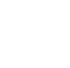

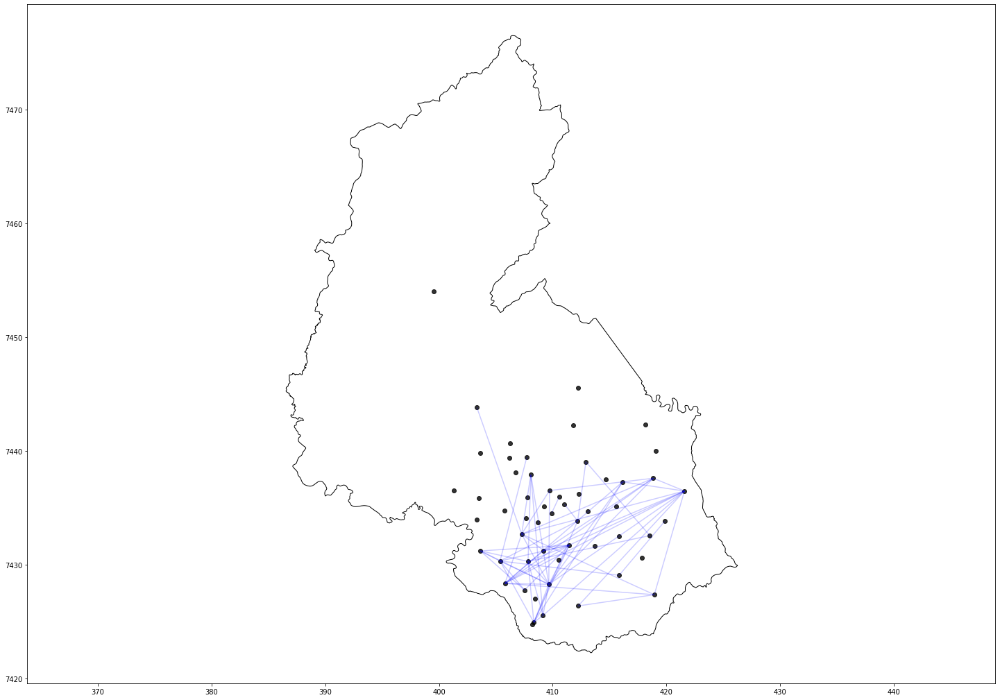

In [366]:
from matplotlib import pyplot as plt
# Setup figure and axis
f, ax = plt.subplots(1, figsize=(1, 1))
# Add tidal water (remove boundary lines for the polygons)

base = sjc.plot(color='white', edgecolor='black', figsize=(25,18))
geo_data_correlations.plot(ax=base, color='blue', figsize=(25,18), alpha=0.2)
geo_data.plot(ax=base, color='black', figsize=(25,18), alpha=0.8)

# Remove axes
ax.set_axis_off()
# Impose same size for units across axes
plt.axis('equal')

plt.savefig('sjc09.png')
plt.savefig('sjc09.pdf')

# Display
plt.show()

##Generating several images for each limiar

In [367]:
list_of_metrics = []

for i in numpy.arange(0, 1, 0.2):
  limiar = round(i, 2)
  g = create_graph(limiar)
  diam = g.diameter(directed=False, unconn=True, weights=None)

  list_of_metrics.append(tuple((limiar, calculate_avg_eccentricity(g), g.average_path_length(directed=True, unconn=True),
                                  g.transitivity_undirected(mode="nan"),
                                  round(mean(g.degree()), 4), g.vcount(), g.ecount(), 
                                  diam, 
                                  len(g.clusters(mode=STRONG)))))

# Create the pandas DataFrame 
metrics = pd.DataFrame(list_of_metrics, columns = ['Limiar', 'avg_eccentricity', 'avg_path_len', 'transitivity' ,'avg_degree', 'num_nodes', 'num_edges', 'diameter', 'clusters'])
metrics




,Limiar,avg_eccentricity,avg_path_len,transitivity,avg_degree,num_nodes,num_edges,diameter,clusters
0,0.0,1.750000,1.039832,0.980581,49.0714,56,1374,2,3
1,0.2,1.982143,1.056604,0.983975,46.5714,56,1304,3,4
2,0.4,1.839286,1.107843,0.971029,42.2500,56,1183,2,5
3,0.6,1.821429,1.137755,0.959052,36.3571,56,1018,3,8
4,0.8,1.732143,1.241414,0.892265,27.0357,56,757,3,12


##Calculating correlations 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/geopandas/plotting.py:503: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=figsize)
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning,

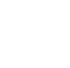

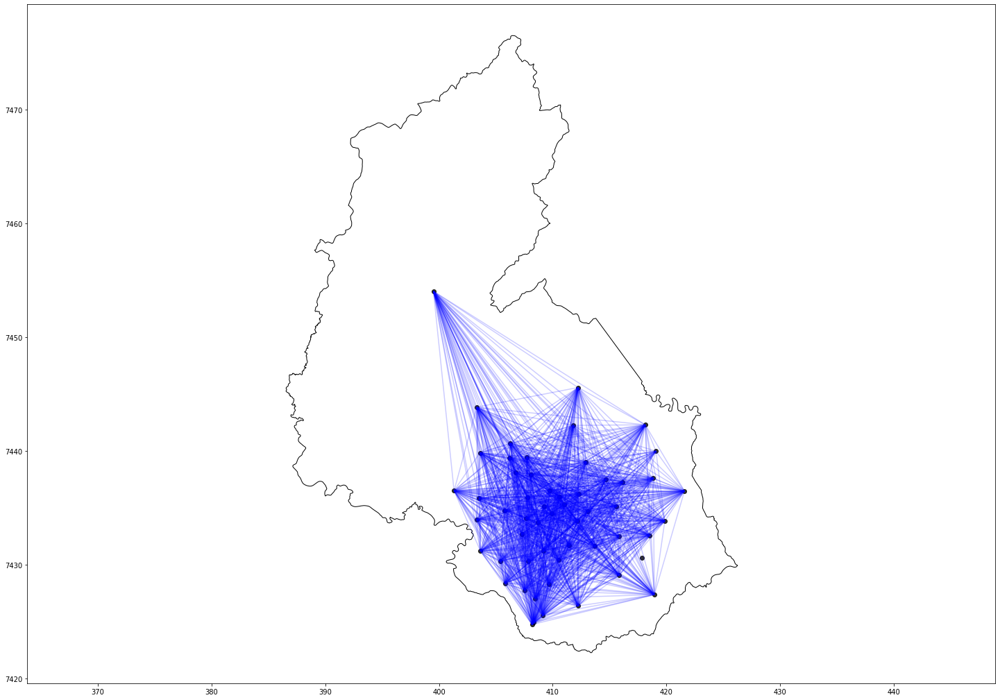

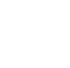

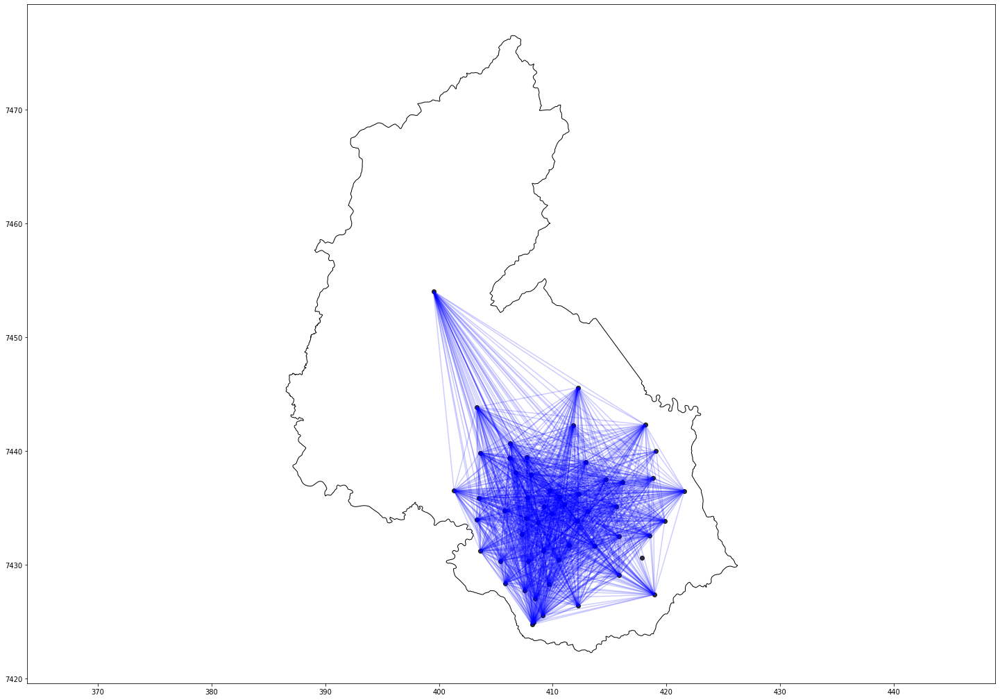

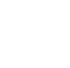

...

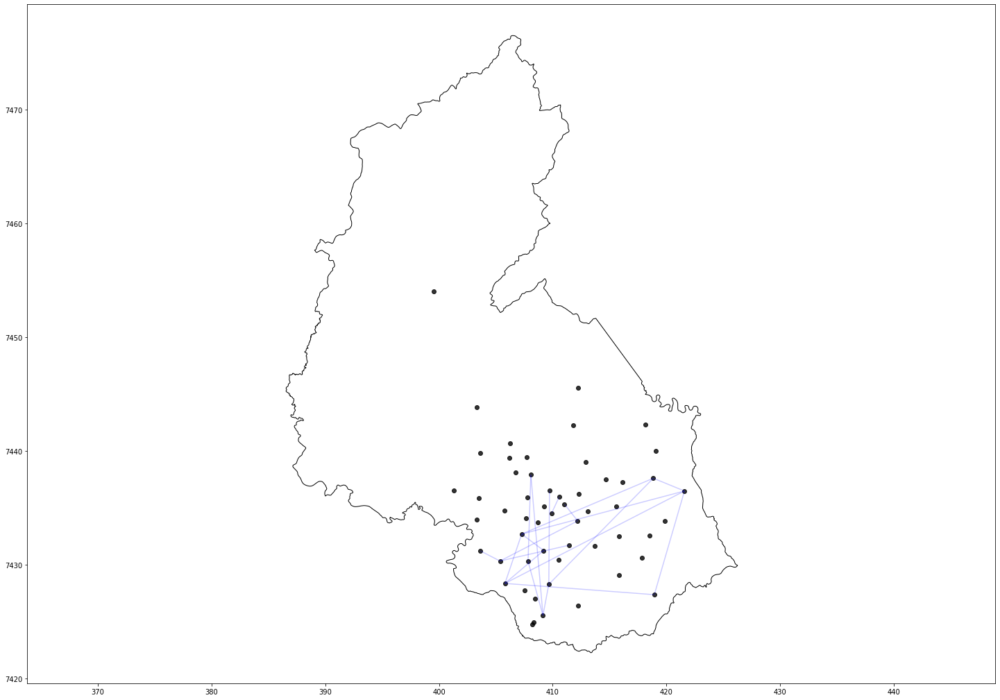

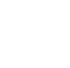

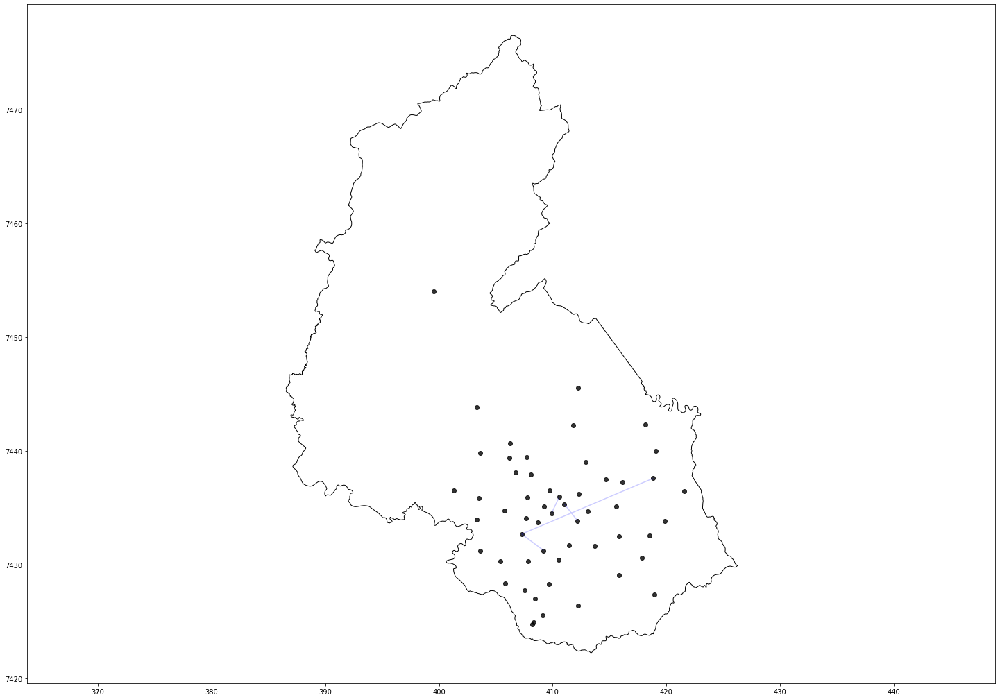

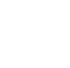

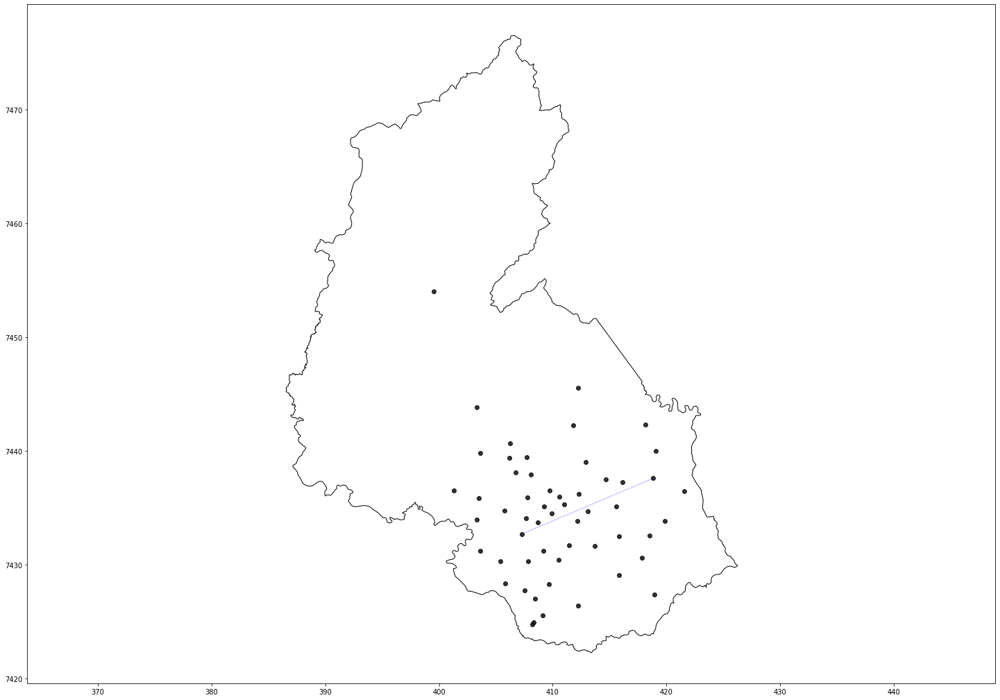

In [368]:
count=0
for i in numpy.arange(0, 1, 0.01):
  correlations = calculate_correlation_with_limiar_x(i)
  correlations = correlations.astype({"X1": int, "X2": int})

  correlations['X1Coord'] = correlations['X1'].apply(lambda x: geo_data.iloc[x-1, 3])
  correlations['X2Coord'] = correlations['X2'].apply(lambda x: geo_data.iloc[x-1, 3])
  correlations
  
  from shapely.geometry import LineString

  y =  zip(correlations.X1Coord, correlations.X2Coord)
  
  geometry = [LineString(xy) for xy in zip(correlations.X1Coord, correlations.X2Coord)]
  crs = {'proj': 'latlong', 'ellps': 'WGS84', 'datum': 'WGS84', 'no_defs': True}

  geo_data_correlations = gpd.GeoDataFrame(correlations, crs = crs, geometry = geometry)
  geo_data_correlations = geo_data_correlations[['X1','X2','geometry']]

  import os

  dir = '../01.Dados/Mapas/SP-DATASET'
  if not os.path.exists(dir):
      os.makedirs(dir)

  geo_data_correlations.to_file(dir + '/DATASET_CORRELATIONS'+str(count)+'.shp')

  from matplotlib import pyplot as plt
  # Setup figure and axis
  f, ax = plt.subplots(1, figsize=(1, 1))
  # Add tidal water (remove boundary lines for the polygons)

  base = sjc.plot(color='white', edgecolor='black', figsize=(25,18))
  geo_data_correlations.plot(ax=base, color='blue', figsize=(25,18), alpha=0.2)
  geo_data.plot(ax=base, color='black', figsize=(25,18), alpha=0.8)

  # Remove axes
  ax.set_axis_off()
  # Impose same size for units across axes
  plt.axis('equal')

  plt.savefig('sjc'+str(count)+'.png')
  count+=1

